# Fourier Transform

## Introduction

The Fourier Transform is used to convert a signal from the time domain to the spectral (frequency) domain. The main idea is to weigh the signal against signals with various frequencies to obtain the contribution of the frequency for describing the given signal. As a result, the importance scores from matching various frequencies against the given signal highlight the amount of Herz (Hz) of the signal given that the time domain is in seconds, allowing for the decomposition of a signal in terms of simpler signals. 
 
Given a signal $g(t)$ where $t$ is the time domain, we want to decompose this signal in terms of its frequencies. The signals that will act as matching weights are simple sine and cosine signals with varying frequencies. A frequency is the amount of oscillations of a signal in one unit of time. The period is the amount of time it takes for one full oscillation of a signal. One naive approach is to use sine waves of various frequencies to match against $g(t)$, i.e., $s(t) = \sin(f t)$ where $f$ is the frequency. However, frequency information will be lost when $g(t)$ has some amount of phase. Instead, using cosine waves results in the opposite behaviour. There seems to be a relationship between sines and cosines when a phase shift is applied to the given signal. Combining sine and cosine waves is the solution to the phase shift problem. An elegant way of representing both a sine and a cosine wave is by using complex numbers, whose real component corresponds to the cosine and the imagenary component corresponds to the sine. Recall that rotations of the unit complex circle correspond to multiplications of complex numbers. Euler's formula gives us the relationship
$$
    e^{xi} = \cos(x) + i\sin(x)
$$
which provides an easy way of organizing rotations in the complex plane. More importantly, for the Fourier Transform, it provides a way to compute sine and cosine signals of various frequencies depending on the value of $x$. Since sine and cosine functions repeat every $2\pi$ radians, we will set $x = 2\pi t$, where $t$ is the time variable. One last adjustment is to multiply $x$ by $-1$, which corresponds to the forward Fourier Transform. This is a convention, as the inverse Fourier transform does not multiply by $-1$. Thus, for example, the function
$$
    s(t) = e^{-2 \pi i t}
$$
is a complex-valued function whose real component $Re(s(t))$ is the cosine function $cos(-2 \pi t)$, and whose imagenary component $Im(s(t))$ is the sine function $sin(-2 \pi t)$. 

The Fourier Transform then corresponds to performing an integration of $g(t)$ multiplied by $e^{-2 \pi i f t}$ to obtain the frequency domain representation $\hat{g}(f)$:
$$
    \hat{g}(f) = \int_{-\infty}^{\infty} g(t) e^{-2 \pi i f t} dt
$$

## Discrete Fourier Transform (DFT)

In the discrete case, we sample $N$ points from the signal, and take the weighted sum with respect to the time vector $t = [t_1, t_2, \dots, t_N]$ between the signal and the unit rotated complex plane with a specific frequency
\begin{align*}
    \hat{g}(f) &= \int_{t_1}^{t_N} g(t) e^{-2 \pi i f t} dt\\
    &= \sum_{t=1}^N g(t) e^{-2 \pi i f t} \\
    &=
    \begin{bmatrix}
        g(t_1) & g(t_2) & \hdots & g(t_N) 
    \end{bmatrix}^T
    \begin{bmatrix}
        e^{-2 \pi i f t_1}\\
        e^{-2 \pi i f t_2}\\
        \vdots\\
        e^{-2 \pi i f t_N}\\
    \end{bmatrix}\\
    &= \textbf{g}^T \textbf{e}
\end{align*}

Given that we want to test $N$ frequencies, $f = [f_1, f_2, \dots, f_N]$, we can also do a matrix multiplication
\begin{align*}
    \hat{\textbf{g}} &= \textbf{g}^T \textbf{E}\\
    &= \begin{bmatrix}
        g(t_1) & g(t_2) & \hdots & g(t_N) 
    \end{bmatrix}^T
    \begin{bmatrix}
        e^{-2 \pi i f_1 t_1} & e^{-2 \pi i f_2 t_1} & \dots & e^{-2 \pi i f_N t_1}\\
        e^{-2 \pi i f_1 t_2} & e^{-2 \pi i f_2 t_2} & \dots & e^{-2 \pi i f_N t_2}\\
        \vdots & \vdots & \ddots & \vdots\\
        e^{-2 \pi i f_1 t_N} & e^{-2 \pi i f_2 t_N} & \dots & e^{-2 \pi i f_N t_N}\\
    \end{bmatrix}
\end{align*}
where $\textbf{g}^T$ is $1\times N$ and $\textbf{E}$ is $N\times N$.

In [2]:
import matplotlib.pyplot as plt
import numpy as np

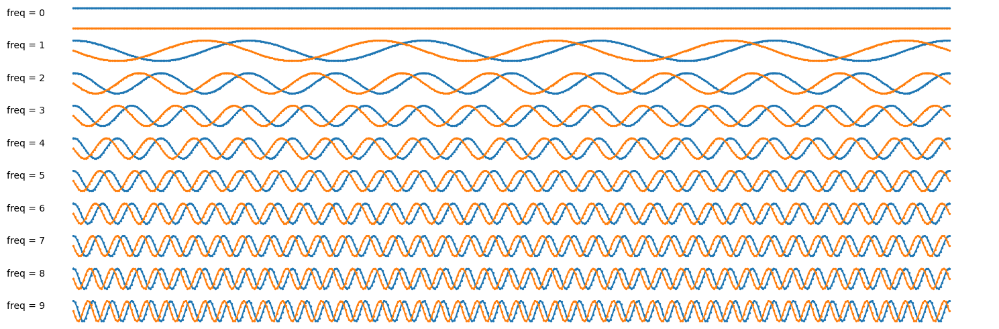

In [2]:
t = np.linspace(0, 5, 500)

n_freqs = 10
f = np.arange(0, n_freqs)[..., None]

s = lambda t: np.exp(-2 * np.pi * 1j * f * t)

s_t = s(t)

fig, axes = plt.subplots(n_freqs, 1, figsize=(15, 5))
axes = axes.flatten()

for i, ax in enumerate(axes):
    ax.plot(t, s_t[i].real, label='real')
    ax.scatter(t, s_t[i].real, s=2)
    ax.plot(t, s_t[i].imag, label='imagenary')
    ax.scatter(t, s_t[i].imag, s=2)
    
    ax.get_xaxis().set_ticks([])
    ax.get_yaxis().set_ticks([])
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.set_ylabel(f'freq = {i}', rotation=0)
    
plt.tight_layout()

## Simple example

Consider the signal
$$
    g(t) = \sin(2\pi 3 t)
$$
which is a signal with 3 Hz. We use a sample frequency $f_s = 40$, which means that the period is $T = 1/f_s$. Furthermore, we sample $N=40$ points, and have a time vector $t$ from $0$ to $N/f_s  = N \cdot T$.

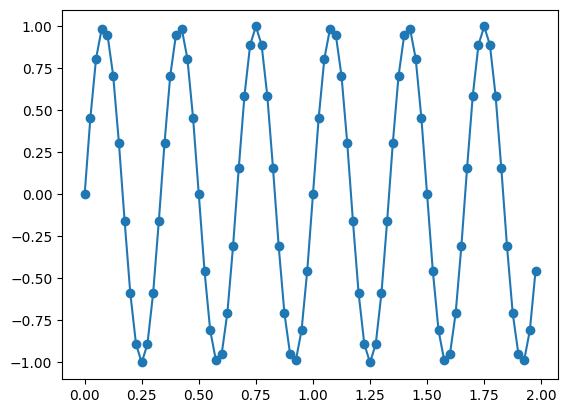

In [9]:
fs = 40                             # sample frequency
T = 1/fs                            # sampling period
N = 80                              # length of the signal
t = np.linspace(0.0, N * T, N, endpoint=False)        # time vector

g = lambda t: np.sin(2*np.pi*3*t)   # 3 Hz signal

g_t = g(t)

plt.plot(t, g_t)
plt.scatter(t, g_t)

## Complex rotations around unit circle

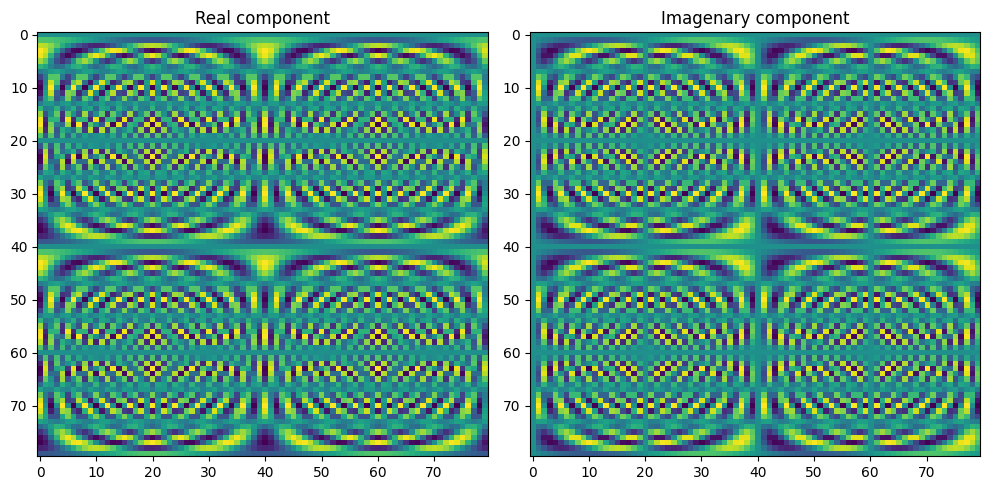

In [31]:
# frequencies from 0 to N
f = np.arange(0, N)

# shape (N, N)
# rows: time vector
# cols: frequencies
rotations = g_t[..., None] * np.exp(-2 * np.pi * 1j * f * t[..., None])

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))
ax1.imshow(rotations.real, aspect='auto')
ax1.set_title('Real component')
ax2.imshow(rotations.imag, aspect='auto')
ax2.set_title('Imagenary component')

plt.tight_layout()

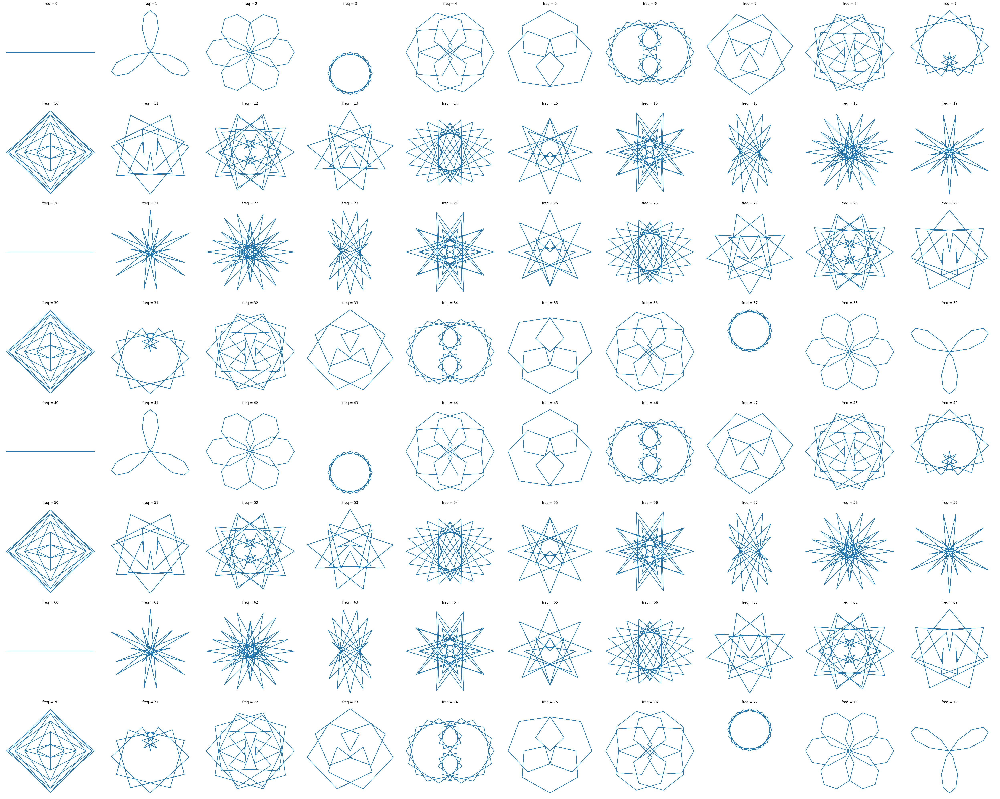

In [38]:
n_rows, n_cols = 8, 10
fig, axes = plt.subplots(n_rows, n_cols, figsize=(5 * n_cols, 5 * n_rows), sharex=True, sharey=True)
axes = axes.flatten()

for i, ax in enumerate(axes):
    ax.plot(rotations[:, i].real, rotations[:, i].imag)
    ax.set_title(f'freq = {i}')
    ax.axis('off')

plt.tight_layout()

We can already see that these is some redundancy in the computation of rotated unit circles multiplied by the signal. Reducing this reduncancy is the basis for the Fast Fourier Transform (FFT)

## Naive DFT implementation

In [6]:
# Discrete Fourier Transform takes a signal g_t, its time vector t, and an array of frequencies
def dft(g_t, t, f):
    # g_t: (N, 1)
    # t: (N, 1)
    # f: (N, ) * t: (N, 1) = (N, N)
    return np.sum(g_t * np.exp((-2 * np.pi * 1j)/(N*T) * f * t), axis=0) 

In [5]:
freqs = np.arange(0, N)
output = dft(g_t[..., None], freqs, t[..., None])
output.shape

(80,)

Plotting real and imagenary part separably gives positive and negative frequency information

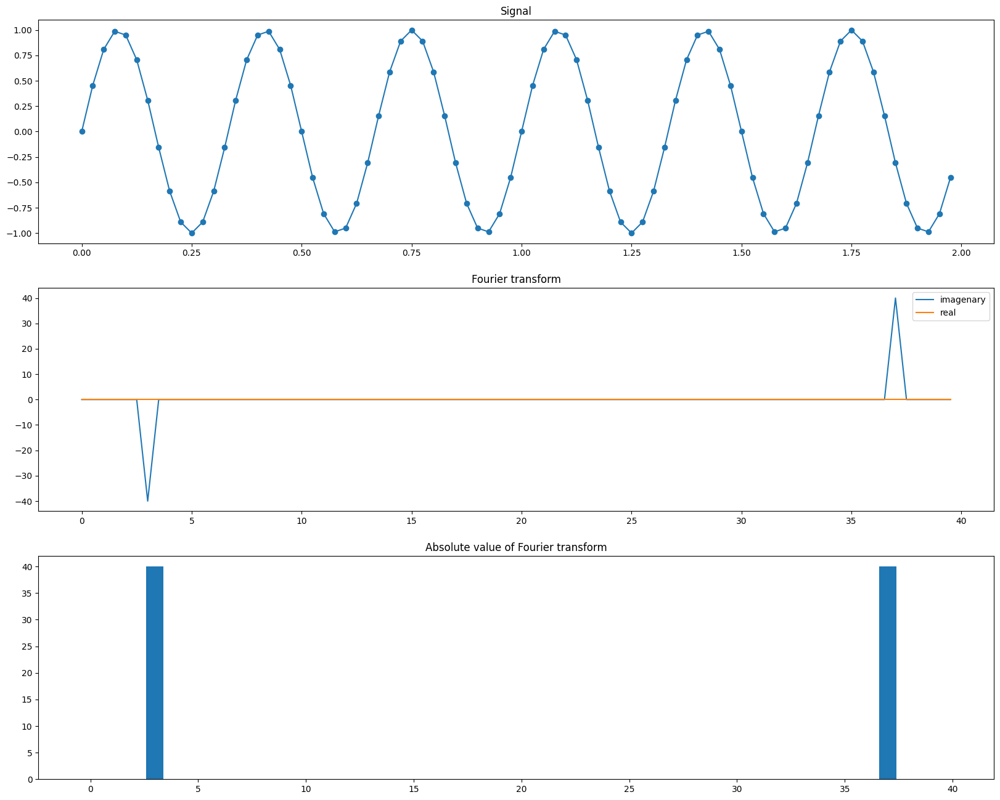

In [6]:
fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(20, 16))

ax1.set_title('Signal')
ax1.plot(t, g_t)
ax1.scatter(t, g_t)

ax2.plot(freqs/(N*T), output.imag, label='imagenary')
ax2.plot(freqs/(N*T), output.real, label='real')
ax2.set_title('Fourier transform')
ax2.legend()

ax3.bar(freqs/(N*T), np.abs(output))
ax3.set_title('Absolute value of Fourier transform')

plt.show()

Looking at the absolute values of the Fourier Transform, the frequency domain is mirrored. Thus, we can take half of the domain and inspect the peak to find which frequencies most contributed to the signal $g(t)$. 

<BarContainer object of 40 artists>

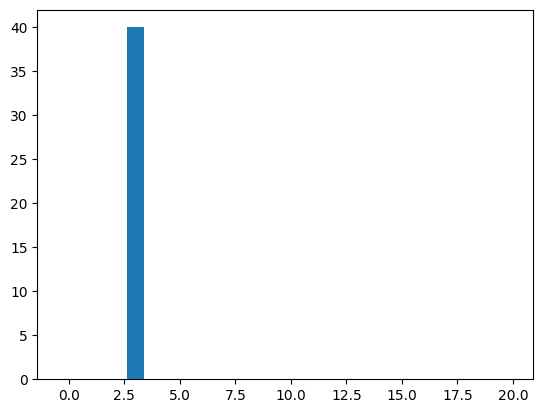

In [7]:
freqs = np.arange(0, N//2)
output = dft(g_t[..., None], freqs, t[..., None])

plt.bar(freqs/(N*T), np.abs(output))

We can rank the frequencies that contributed from most relevant to least relevant. As can be seen, a frequency of 3 is the most contributing frequency, which makes sense, as $g(t)$ is a 3 Hz signal, i.e., it has a frequency of 3.

In [8]:
max_indices = np.abs(output).argsort()[::-1]
max_indices/(N*T)

array([ 3. , 19.5, 15. , 18.5, 12. , 13.5, 16.5, 17. , 18. , 11.5,  7. ,
       13. , 15.5, 17.5, 19. , 11. ,  9.5,  5. , 14. ,  7.5, 16. , 12.5,
       14.5,  5.5,  9. ,  6.5,  4. , 10. ,  6. ,  3.5,  8.5,  2. ,  8. ,
        2.5,  1. ,  1.5, 10.5,  0.5,  0. ,  4.5])

## DFT as matrix multiplication

The alternative way of computing the DFT is via matrix multiplication

In [9]:
freqs = np.arange(0, N)
freq_weights = np.exp(-2 * np.pi * 1j * freqs * t[..., None] * (1/(N*T)))

freq_weights.shape, g_t.shape

((80, 80), (80,))

<BarContainer object of 40 artists>

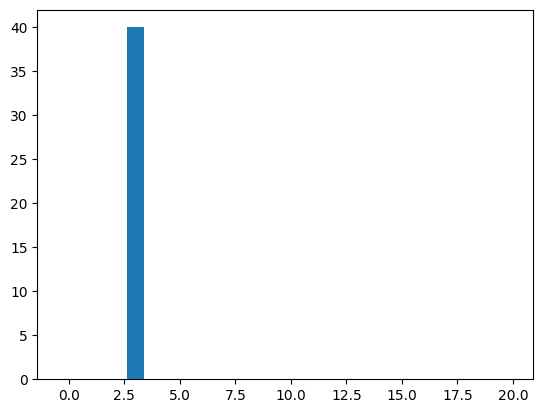

In [10]:
G = g_t @ freq_weights 

plt.bar(freqs[:N//2] / (N*T), np.abs(G)[:N//2])

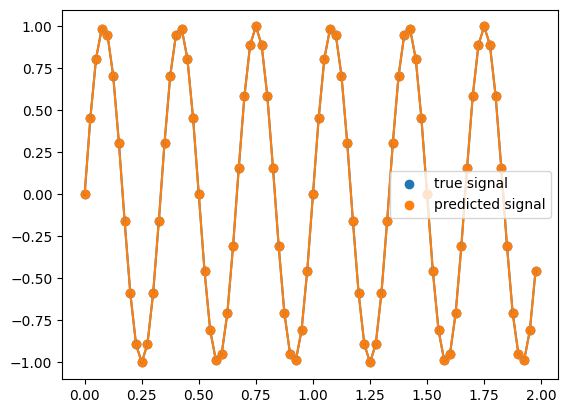

In [11]:
g_pred = G @ (1/N * freq_weights**-1)

plt.plot(t, g_t, c='C0')
plt.scatter(t, g_t, c='C0', label='true signal')

plt.plot(t, g_pred.real, c='C1')
plt.scatter(t, g_pred.real, c='C1', label='predicted signal')

plt.legend()

## More complex example

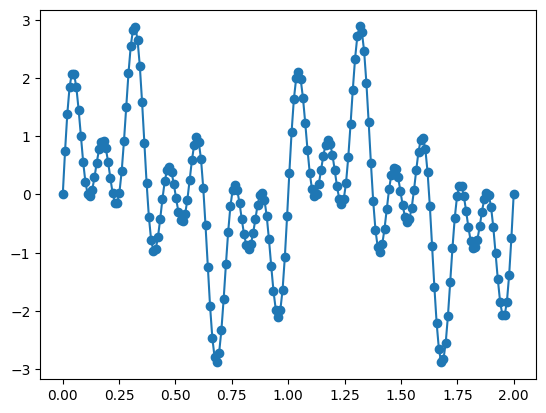

In [16]:
fs = 100                             # sample frequency
T = 1/fs                            # sampling period
N = 200                             # length of the signal
t = np.linspace(0, N * T, N)        # time vector

Hz = [1, 4, 7]

g = lambda t, Hz: np.sum([np.sin(2*np.pi*h*t) for h in Hz], axis=0)

g_t = g(t, Hz)

plt.plot(t, g_t)
plt.scatter(t, g_t)

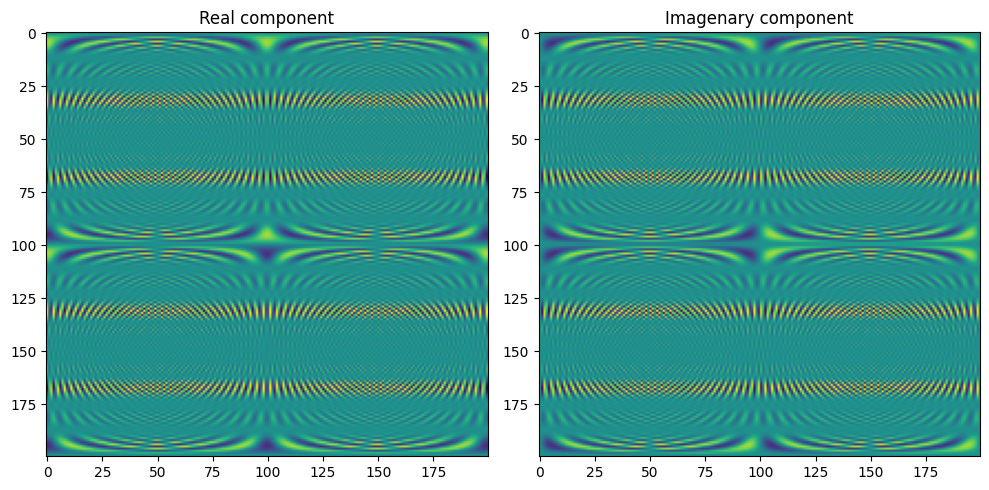

In [3]:
# frequencies from 0 to N
f = np.arange(0, N)

# shape (N, N)
# rows: time vector
# cols: frequencies
rotations = g_t[..., None] * np.exp(-2 * np.pi * 1j * f * t[..., None])

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))
ax1.imshow(rotations.real, aspect='auto')
ax1.set_title('Real component')
ax2.imshow(rotations.imag, aspect='auto')
ax2.set_title('Imagenary component')

plt.tight_layout()

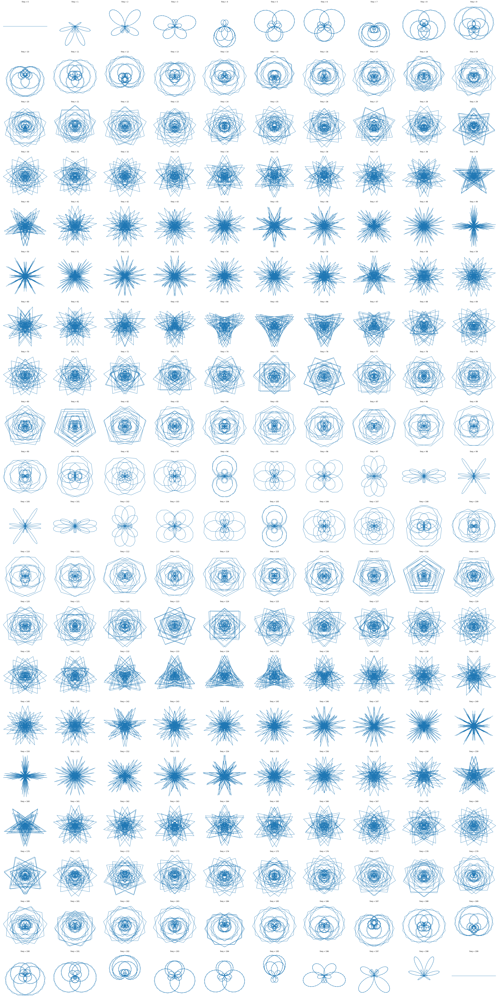

In [4]:
n_rows, n_cols = 20, 10
fig, axes = plt.subplots(n_rows, n_cols, figsize=(5 * n_cols, 5 * n_rows), sharex=True, sharey=True)
axes = axes.flatten()

for i, ax in enumerate(axes):
    ax.plot(rotations[:, i].real, rotations[:, i].imag)
    ax.set_title(f'freq = {i}')
    ax.axis('off')

plt.tight_layout()

In [17]:
freqs = np.arange(0, N)
output = dft(g_t[..., None], freqs, t[..., None])
output.shape

(200,)

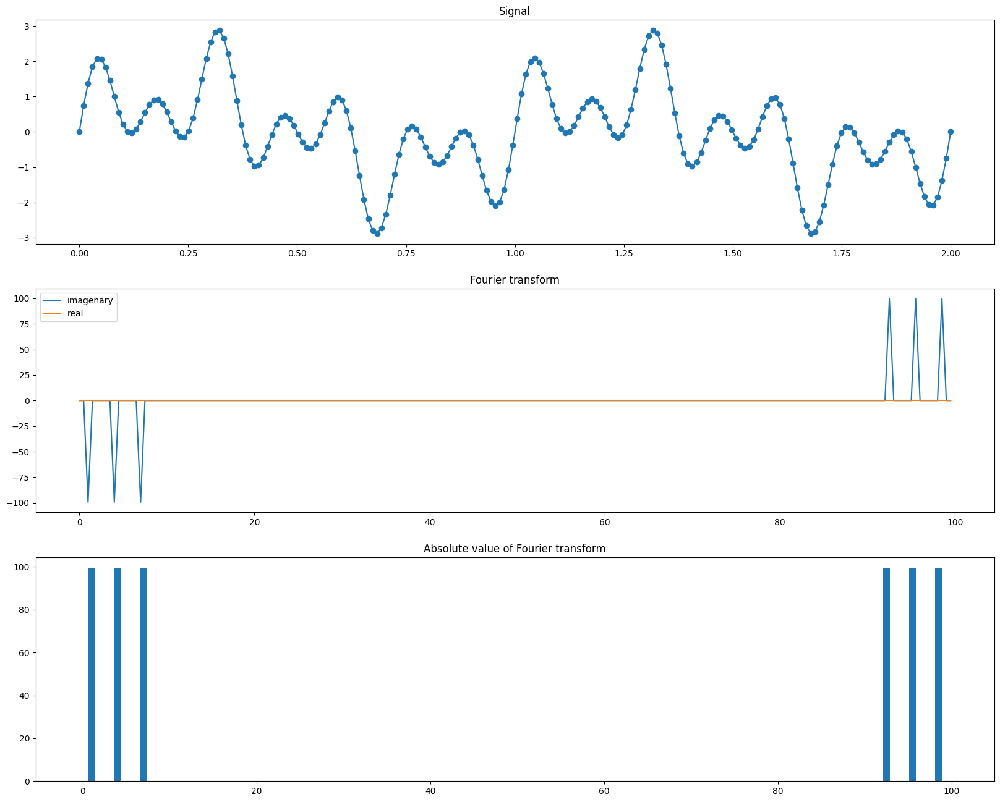

In [18]:
fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(20, 16))

ax1.set_title('Signal')
ax1.plot(t, g_t)
ax1.scatter(t, g_t)

ax2.plot(freqs/(N*T), output.imag, label='imagenary')
ax2.plot(freqs/(N*T), output.real, label='real')
ax2.set_title('Fourier transform')
ax2.legend()

ax3.bar(freqs/(N*T), np.abs(output))
ax3.set_title('Absolute value of Fourier transform')

plt.show()

In [19]:
np.abs(output)[:N//2 + 1].argsort()[::-1] / (N*T)

array([ 7. ,  4. ,  1. , 42.5, 44. , 47.5, 40. , 39.5, 26. , 34.5, 46.5,
       49.5, 41.5, 37. , 43.5, 19.5, 50. , 45.5, 42. , 20. , 27. , 44.5,
       23.5, 47. , 26.5, 48. , 36.5, 31.5, 33.5, 38.5, 16.5, 28. , 19. ,
       49. , 37.5, 23. , 29.5, 22.5, 18.5, 15.5, 30. , 35. , 48.5, 15. ,
       25. , 40.5, 46. , 14.5, 24.5, 32.5, 38. , 30.5, 12. , 21.5, 17. ,
       27.5, 45. , 34. , 29. , 41. , 22. , 36. , 33. , 10. , 14. , 21. ,
       20.5, 12.5, 31. , 28.5, 10.5, 11.5, 13.5, 35.5, 43. , 25.5,  9. ,
       11. , 18. , 39. , 13. , 32. , 24. ,  8. ,  3.5,  5.5,  3. ,  7.5,
       16. ,  6. , 17.5,  1.5,  5. ,  4.5,  2.5,  8.5,  6.5,  2. ,  9.5,
        0.5,  0. ])

<BarContainer object of 101 artists>

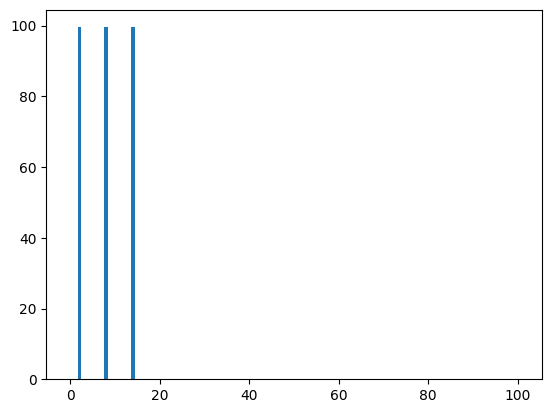

In [20]:
freqs = np.arange(0, N//2+1)

freq_weights = np.exp(-2 * np.pi * 1j * freqs * t[..., None] * (1/(N*T)))

G = g_t @ freq_weights

plt.bar(freqs, np.abs(G))

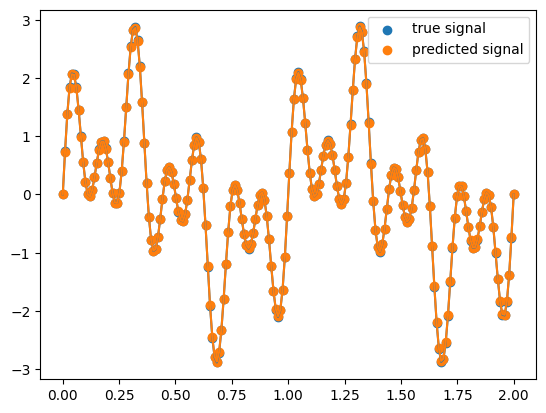

In [22]:
freqs = np.arange(0, N)
freq_weights = np.exp(-2 * np.pi * 1j * freqs * t[..., None] * (1/(N*T)))

G = g_t @ freq_weights

g_pred = G @ (1/N * freq_weights**-1)

plt.plot(t, g_t, c='C0')
plt.scatter(t, g_t, c='C0', label='true signal')

plt.plot(t, g_pred.real, c='C1')
plt.scatter(t, g_pred.real, c='C1', label='predicted signal')

plt.legend()

## Using np.fft

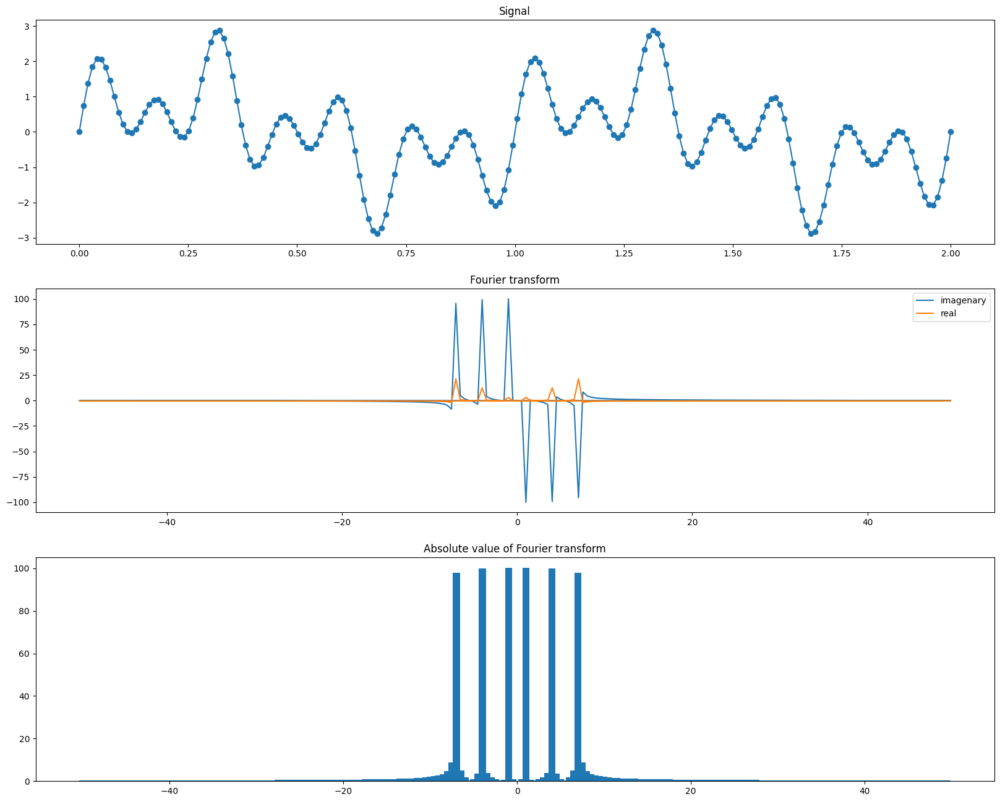

In [12]:
fft = np.fft.fft(g_t)
fft_freqs = np.fft.fftfreq(N, d=T)

fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(20, 16))

ax1.set_title('Signal')
ax1.plot(t, g_t)
ax1.scatter(t, g_t)

ax2.plot(fft_freqs, fft.imag, label='imagenary')
ax2.plot(fft_freqs, fft.real, label='real')
ax2.set_title('Fourier transform')
ax2.legend()

ax3.bar(fft_freqs, np.abs(fft))
ax3.set_title('Absolute value of Fourier transform')

plt.show()

In [15]:
np.abs(fft)[:N//2 + 1].argsort()[::-1] / (N*T)

array([ 1. ,  4. ,  7. ,  7.5,  6.5,  8. ,  3.5,  4.5,  8.5,  9. ,  9.5,
       10. ,  3. , 10.5,  6. , 11. , 11.5, 12. , 12.5, 13. , 13.5, 14. ,
        5. , 14.5, 15. , 15.5,  2.5, 16. , 16.5,  0.5, 17. , 17.5, 18. ,
       18.5, 19. , 19.5, 20. , 20.5, 21. , 21.5, 22. , 22.5, 23. , 23.5,
       24. , 24.5,  1.5, 25. , 25.5, 26. , 26.5, 27. , 27.5, 28. , 28.5,
       29. , 29.5, 30. , 30.5, 31. , 31.5, 32. , 32.5, 33. , 33.5, 34. ,
       34.5, 35. , 35.5, 36. , 36.5, 37. , 37.5, 38. , 38.5, 39. , 39.5,
       40. , 40.5, 41. , 41.5, 42. , 42.5, 43. , 43.5, 44. , 44.5, 45. ,
       45.5, 46. , 46.5, 47. , 47.5, 48. , 48.5, 49. , 49.5, 50. ,  2. ,
        5.5,  0. ])

Text(0.5, 1.0, 'Absolute value of Fourier transform')

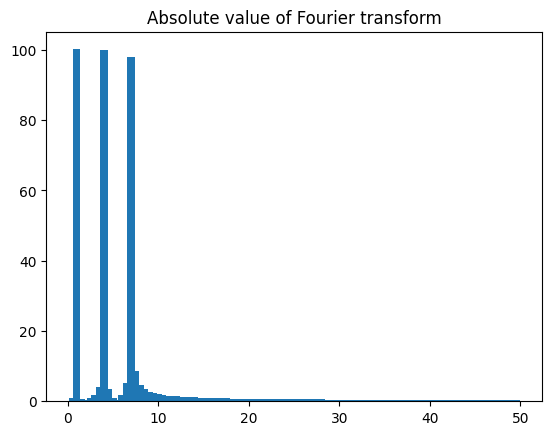

In [19]:
plt.bar(fft_freqs[fft_freqs > 0], np.abs(fft[fft_freqs > 0]))
plt.title('Absolute value of Fourier transform')

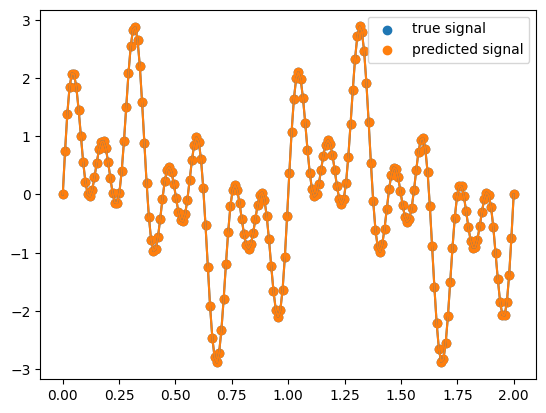

In [20]:
inv_fft = np.fft.ifft(fft)

plt.plot(t, g_t, c='C0')
plt.scatter(t, g_t, c='C0', label='true signal')

plt.plot(t, inv_fft.real, c='C1')
plt.scatter(t, inv_fft.real, c='C1', label='predicted signal')

plt.legend()

# Fast Fourier Transform (FFT)

The Fast Fourier Transform (FFT), proposed by Cooley and Tukey in 1965 and earlier described by Gauss in 1805, is a much faster version of the regular DFT. Recall that to compute the matrix product 

\begin{align*}
    \hat{\textbf{g}} &= \textbf{g}^T \textbf{E}\\
    &= \begin{bmatrix}
        g(t_1) & g(t_2) & \hdots & g(t_N) 
    \end{bmatrix}^T
    \begin{bmatrix}
        e^{-2 \pi i f_1 t_1} & e^{-2 \pi i f_2 t_1} & \dots & e^{-2 \pi i f_N t_1}\\
        e^{-2 \pi i f_1 t_2} & e^{-2 \pi i f_2 t_2} & \dots & e^{-2 \pi i f_N t_2}\\
        \vdots & \vdots & \ddots & \vdots\\
        e^{-2 \pi i f_1 t_N} & e^{-2 \pi i f_2 t_N} & \dots & e^{-2 \pi i f_N t_N}\\
    \end{bmatrix}
\end{align*}
in the worst case, we need $N^2$ computations, because $\hat{\textbf{g}}_f = \sum_{t=1}^N g(t) e^{-2 \pi i f t}$ takes $N$ computations for all $f = 1, 2, \dots, N$, which means that the regular DFT is $O(N^2)$. Instead, the FFT algorithm is $O(N \log N)$, which can be achieved by careful consideration of the symmetries in the $\mathbf{E}$ matrix. 


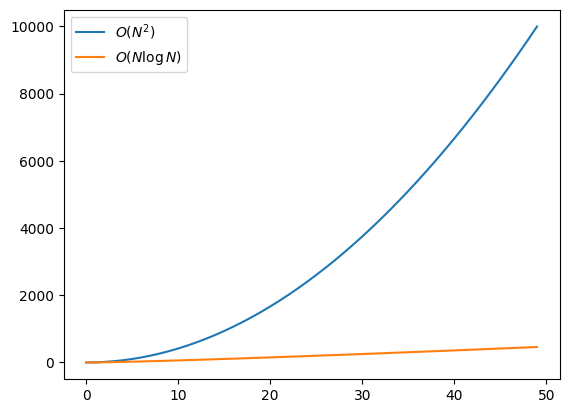

In [8]:
n = np.linspace(0.001, 100)
plt.plot(n**2, label=r'$O(N^2)$')
plt.plot(n*np.log(n), label=r'$O(N \log N)$')
plt.legend()

## Symmetries of fourier transform

Let $\omega_N = e^{-i 2 \pi / N} = \exp\left\{-i \frac{2 \pi}{N}\right\}$ as a shorthand. FFT exploits two main symmetries in the complex exponentials. 

### 1. Complex conjugate symmetry

It can be shown that $\omega_N^{f (N-t)} = \omega_N^{-ft} = (\omega_N^{ft})^*$.

First, the symmetry $\omega_N^{f(N-t)} = \omega_N^{-ft}$ needs to be proven:
\begin{*align}
    \omega_N^{f(N-t)} &= \exp\left\{-i \frac{2 \pi}{N} \cdot f(N-t) \right\} \\
    &= \exp\left\{-i 2 \pi f + i \frac{2 \pi}{N} f t \right\} \\
    &= \exp\left\{-i 2 \pi f\right\} \cdot \exp\left\{ i \frac{2 \pi}{N} f t \right\} \\
    &= (1+0 i) \cdot \exp\left\{- i \frac{2 \pi}{N} (-f t) \right\} \\
    &= \exp\left\{- i \frac{2 \pi}{N} (-f t) \right\} = \omega_N^{-ft}
\end{*align}

Next, the symmetry $\omega_N^{-ft} = (\omega_N^{ft})^*$ needs to be proven
\begin{*align}
    \omega_N^{-ft} &= \exp\left\{- i \frac{2 \pi}{N} (-f t) \right\} \\
    &= \underbrace{\cos\left( - \frac{2 \pi}{N} (-f t) \right)}_{\cos(-\theta) = \cos(\theta)} + i \underbrace{\sin\left( -\frac{2 \pi}{N} (-f t) \right)}_{\sin(-\theta) = -\sin(\theta)}\\
    &= \cos\left( - \frac{2 \pi}{N} f t \right) - i \sin\left( -\frac{2 \pi}{N} f t \right)\\
    &= \left(\exp\left\{- i \frac{2 \pi}{N} f t \right\}\right)^* = (\omega_N^{ft})^*
\end{*align}

### 2. Complex periodicity in $t, f$

It can be shown that $\omega_N^{ft} = \omega_N^{f(N+t)} = \omega_N^{(f+N)t}$

Starting off with $\omega_N^{f(N+t)}$, we get
\begin{*align}
    \omega_N^{f(N+t)} &= \exp\left\{- i \frac{2 \pi}{N} f(N + t) \right\}\\
    &= \exp\left\{- i 2 \pi f - i \frac{2 \pi}{N} f t \right\}\\
    &= \exp\left\{- i 2 \pi f\right\} \cdot \exp\left\{ - i \frac{2 \pi}{N} f t \right\}\\
    &= (1 + 0i) \cdot \exp\left\{ - i \frac{2 \pi}{N} f t \right\}\\
    &= \omega_N^{ft}
\end{*align}

Likewise for $\omega_N^{(f+N)t}$, we get
\begin{*align}
    \omega_N^{(f+N)t} &= \exp\left\{- i \frac{2 \pi}{N} (f+N)t \right\}\\
    &= \exp\left\{- i \frac{2 \pi}{N} f t - i 2 \pi t \right\}\\
    &= \exp\left\{ - i \frac{2 \pi}{N} f t \right\} \cdot  \exp\left\{- i 2 \pi t\right\}\\
    &= \exp\left\{ - i \frac{2 \pi}{N} f t \right\} \cdot (1 + 0i)\\
    &= \omega_N^{ft}
\end{*align}

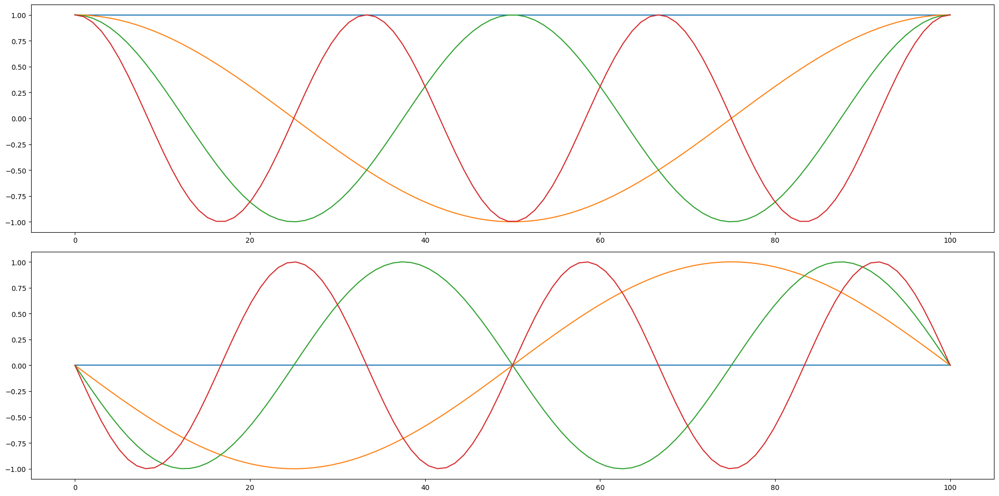

In [20]:
N = 100
t = np.linspace(0, 100, 100)

n_freqs = 4
f = np.arange(0, n_freqs)[..., None]

omega = np.exp(-2 * np.pi * 1j * 1/N)

fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(20, 10))

for i in range(n_freqs):
    ax1.plot(t, (omega**(i*t)).real, label='real')
    
for i in range(n_freqs):
    ax2.plot(t, (omega**(i*t)).imag, label='imagenary')
    
plt.tight_layout()

## Divide and Conquer

Having established these symmetries, the idea is to separate the time sequence $g(t)$ into even and odd-indexed subsequences. A sequence of length $N$, where we assume $N = 2^m$, can be split into its even and odd indices via 
$$
    t = \begin{cases}
        2r & \text{ if even}\\
        2r + 1 & \text{ if odd}
    \end{cases}, \qquad \forall r = 0, 1, 2, \dots, \frac{N}{2}-1
$$
Due to the linearity of the sum operator, we therefore get
\begin{*align}
    \hat{g}(f) &= \sum_{t=0}^{N-1} g(t) \omega_N^{ft}\\
    &= \sum_{r = 0}^{\frac{N}{2}-1} g(2r) \omega_N^{f 2 r} + \sum_{r = 0}^{\frac{N}{2}-1} g(2r+1) \underbrace{\omega_N^{f (2r+1)}}_{= \omega_N^{f (2r)} \cdot \omega_N^{f}}\\
    &= \sum_{r = 0}^{\frac{N}{2}-1} g(2r) \left(\omega_N^{2}\right)^{f r} + \omega_N^{f} \sum_{r = 0}^{\frac{N}{2}-1} g(2r+1) \left(\omega_N^{2}\right)^{f r}
\end{*align}
Due to the symmetry
$$
    \omega_N^{2} = \exp\left\{-i \frac{2 \pi}{N} \cdot 2\right\} = \exp\left\{-i \frac{4 \pi}{N}\right\} = \exp\left\{-i \frac{2 \pi}{N/2}\right\} = \omega_{N/2}
$$
we can rewrite the even and odd parts as two $N/2$ DFTs.
\begin{*align}
    \hat{g}(f) &= \sum_{r = 0}^{\frac{N}{2}-1} g(2r) \omega_{N/2}^{f r} + \omega_N^{f} \sum_{r = 0}^{\frac{N}{2}-1} g(2r+1) \omega_{N/2}^{f r}\\
    \hat{g}(f) &= \hat{g}_{\text{even}}(f) + \omega_N^{f} \hat{g}_{\text{odd}}(f)
\end{*align} 

The amount of computations needed is now $(N/2)^2 \cdot 2 + N = N^2/2 + N$, because the matrix vector product now takes $(N/2)^2$ computations. There are now 2 matrix products for the even and odd indices. We also need to add $N$ because the even and odd sampled DFTs need to be combined again.  

If we keep splitting the even and odd subsequences into smaller subsequences, we end up with order $O(N \log N)$ for large $N$. 

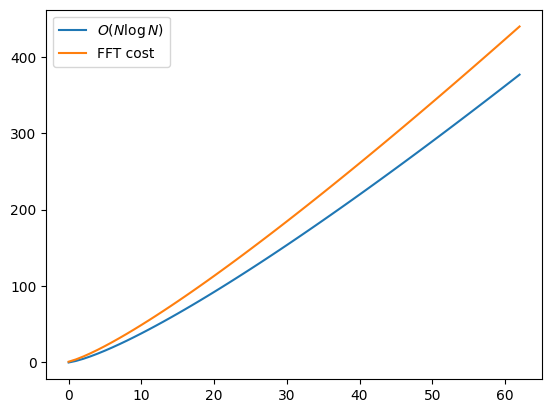

In [28]:
n = np.arange(1, 2**6)
plt.plot(n*np.log2(n), label=r'$O(N \log N)$')

cost = n**2 / n + n*np.log2(n)
plt.plot(cost, label=r'FFT cost')

plt.legend()

<StemContainer object of 3 artists>

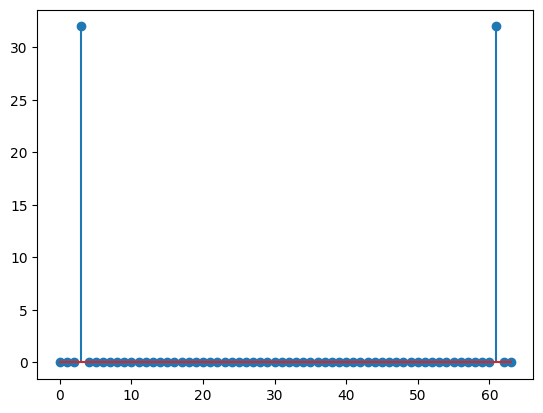

In [21]:
def FFT(g_t):
    N = len(g_t)
    if N == 1:
        return g_t
    omega = np.exp(-2 * np.pi * 1j / N)
    g_t_even, g_t_odd = g_t[::2], g_t[1::2]
    y_even, y_odd = FFT(g_t_even), FFT(g_t_odd)
    
    y = np.zeros((N,), dtype=np.complex64)
    
    j = np.arange(0, N//2)
    omega_powers = omega**j
    y[:N//2] = y_even + omega_powers * y_odd
    y[N//2:] = y_even - omega_powers * y_odd
    
    return y

def IFFT(signal):
    def _IFFT(g_t):
        N = len(g_t)
        if N == 1:
            return g_t
        omega = np.exp(2 * np.pi * 1j / N)
        g_t_even, g_t_odd = g_t[::2], g_t[1::2]
        y_even, y_odd = _IFFT(g_t_even), _IFFT(g_t_odd)
        
        y = np.zeros((N,), dtype=np.complex64)
        
        j = np.arange(0, N//2)
        omega_powers = omega**j
        y[:N//2] = y_even + omega_powers * y_odd
        y[N//2:] = y_even - omega_powers * y_odd
        
        return y
    
    return _IFFT(signal) / len(signal)
    
# naive FFT implementation only works for N that are powers of 2 
N = 64                              # length of the signal
t = np.linspace(0.0, 1.0, N, endpoint=False)        # time vector

g = lambda t: np.sin(2*np.pi*3*t)   # 3 Hz signal
g_t = g(t)

y = FFT(g_t)
plt.stem(np.abs(y))

In [22]:
np.abs(y)[:N//2].argmax()

np.int64(3)

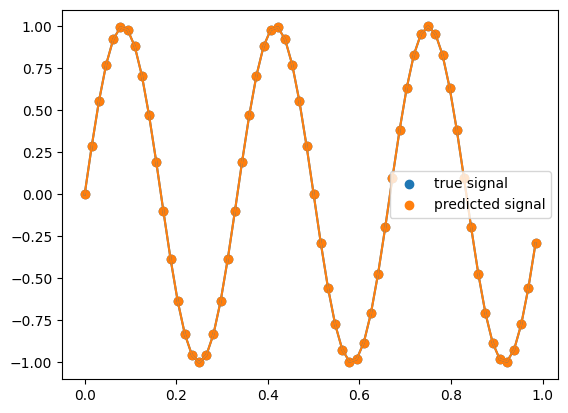

In [24]:
g_hat_t = IFFT(y)

plt.plot(t, g_t, c='C0')
plt.scatter(t, g_t, c='C0', label='true signal')

plt.plot(t, g_hat_t, c='C1')
plt.scatter(t, g_hat_t, c='C1', label='predicted signal')

plt.legend()

# Audio example

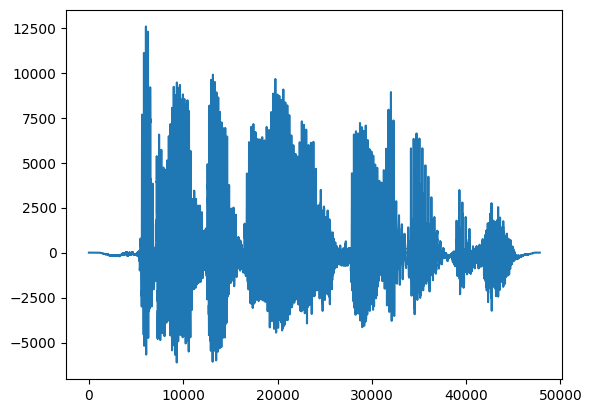

In [23]:
from scipy.io.wavfile import read, write
a = read("../datasets/audio.wav")

audio = np.array(a[1],dtype=float)

plt.plot(audio)

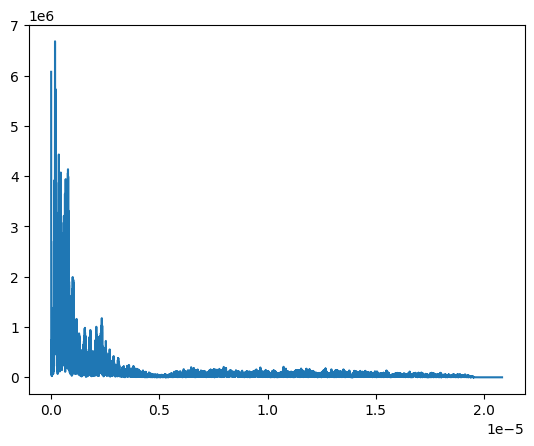

In [24]:
N = len(audio)
fft = np.fft.fft(audio)
fft_freqs = np.fft.fftfreq(N, d=a[0])

plt.plot(fft_freqs[:N//2], np.abs(fft[:N//2]))

## Filter top $n$% highest frequencies 

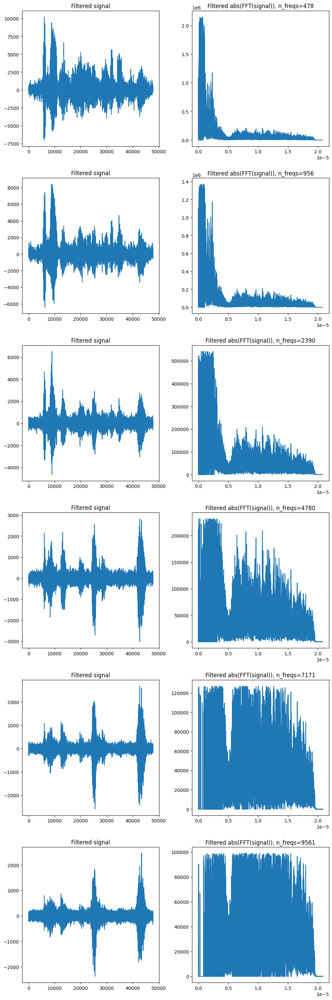

In [25]:
n_percentiles = [1, 2, 5, 10, 15, 20]
filter_n_freqs = [int(N * i/100) for i in n_percentiles]

fig, axes = plt.subplots(len(filter_n_freqs), 2, figsize=(10, 5*len(filter_n_freqs)))

for i, (n_freqs, (ax1, ax2)) in enumerate(zip(filter_n_freqs, axes)):
    
    # copy FFT
    fft_filtered = np.copy(fft)
    
    # filter based on first n_freqs highest magnitude frequencies, set them to zero
    sorted_indices = np.argsort(np.abs(fft_filtered))[::-1]
    fft_filtered[sorted_indices[:n_freqs]] = 0
    
    # inverse FFT
    inv_fft_filtered = np.fft.ifft(fft_filtered).real.astype(np.int16)
    
    # save audio file
    write(f'../datasets/audio_sample/audio_remove_{n_percentiles[i]}percent.wav', a[0], inv_fft_filtered)
    
    ax1.set_title('Filtered signal')
    ax1.plot(inv_fft_filtered)
    
    ax2.set_title(f'Filtered abs(FFT(signal)), {n_freqs=}')
    ax2.plot(fft_freqs[:N//2], np.abs(fft_filtered[:N//2]))

plt.tight_layout()

## Filter top $n$% lowest frequencies 

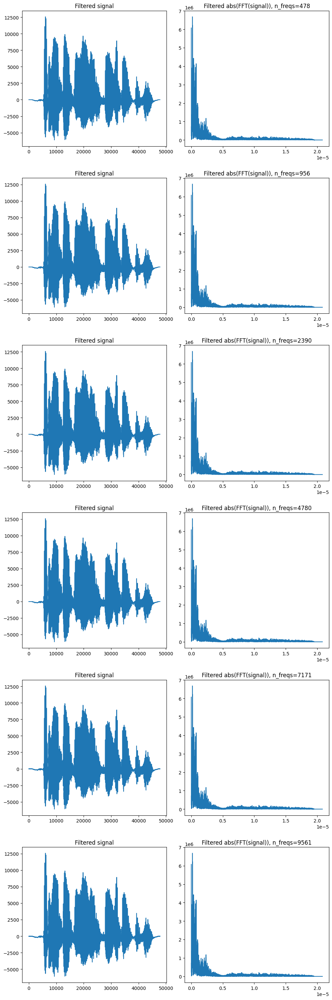

In [26]:
n_percentiles = [1, 2, 5, 10, 15, 20]
filter_n_freqs = [int(N * i/100) for i in n_percentiles]

fig, axes = plt.subplots(len(filter_n_freqs), 2, figsize=(10, 5*len(filter_n_freqs)))

for i, (n_freqs, (ax1, ax2)) in enumerate(zip(filter_n_freqs, axes)):
    
    # copy FFT
    fft_filtered = np.copy(fft)
    
    # filter based on percentage threshold 
    # lowest n_freqs frequencies get filtered out
    fft_filtered[np.abs(fft_filtered) < n_freqs] = 0
    
    # inverse FFT
    inv_fft_filtered = np.fft.ifft(fft_filtered).real.astype(np.int16)
    
    # save audio file
    write(f'../datasets/audio_sample/audio_filter_{n_percentiles[i]}p_freqs.wav', a[0], inv_fft_filtered)
    
    ax1.set_title('Filtered signal')
    ax1.plot(inv_fft_filtered)
    
    ax2.set_title(f'Filtered abs(FFT(signal)), {n_freqs=}')
    ax2.plot(fft_freqs[:N//2], np.abs(fft_filtered[:N//2]))

plt.tight_layout()